In [1]:
import copy 
import json

ATTACK = '1'
BENIGN = '0'

with open("../../data/pre_process/dissection_clean/both.json") as f:
    my_json = json.load(f)

dict_by_type = {
    "discovery" : [],
    "addNf"     : [],
    "removeNf"  : [],
    "sessionDeletion"      : [],
    "sessionModification"  : [],
    "sessionEstablishment" : [],
    "gtp"         : [],
    "pfcp_in_gtp" : [],
    "seid_fuzzing": []
}

dict = {
    ATTACK: copy.deepcopy(dict_by_type),
    BENIGN: copy.deepcopy(dict_by_type)
}

for dissected_pkt in my_json:

    is_attack = dissected_pkt["common"]["is_attack"]

    if "http2" in dissected_pkt["protocols"]:

        for layer in dissected_pkt["protocols"]["http2"]:

            if "path" in layer:

                # Discovery Requests
                if "/nnrf-disc" in layer["path"]:
                    dict[is_attack]["discovery"].append(dissected_pkt)

                # Add and remove NF Requests
                if "/nnrf-nfm" in layer["path"]:

                    if layer["method"] == "PUT":
                        dict[is_attack]["addNf"].append(dissected_pkt)
                    elif layer["method"] == "DELETE":
                        dict[is_attack]["removeNf"].append(dissected_pkt)

                # Any fuzzing request
                if "/nudm" in layer["path"] or "/namf" in layer["path"]:

                    path_to_correct = [
                        ("/namf-callback/v1/smContextStatus/imsi/"),
                        ("/nudm-sdm/v2/imsi/sdm-subscriptions/"),
                        ("/namf-mt/v1/ue-contexts","ue-reachind"),
                        ("/nudm-rsds/v1","sm-delivery-status"),
                        ("/nudm-ssau/v1", "AF_GUIDANCE_FOR_URSP/authorize"),
                        ("/namf-comm/v1/ue-contexts","n1-n2-messages/subscriptions"),
                        ("/nudm-sdm/v2","lcs-privacy-data"),
                        ("/namf-comm/v1/ue-contexts","n1-n2-messages"),
                        ("/nudm-ssau/v1","AF_GUIDANCE_FOR_URSP"),
                        ("/namf-mbs-bc/v1/mbs-contexts"),
                        ("/namf-comm/v1/ue-contexts/")
                    ]

                    for path_parts in path_to_correct:
                        all_parts = True
                        for path_part in path_parts:
                            if path_part not in layer["path"]:
                                all_parts = False
                        if all_parts:
                            if len(path_parts) == 2:
                                layer["path"] = "/".join(path_parts)
                            else :
                                layer["path"] = path_parts

                    if layer["path"] not in dict[is_attack]:
                        dict[is_attack][layer["path"]] = []

                    dict[is_attack][layer["path"]].append(dissected_pkt)

    if "pfcp" in dissected_pkt["protocols"]:

        for layer in dissected_pkt["protocols"]["pfcp"]:

            if "msg_type" in layer:

                # PFCP Deletion Requests
                if int(layer["msg_type"]) == 54:
                    dict[is_attack]["sessionDeletion"].append(dissected_pkt)

                # PFCP Modification Requests
                if int(layer["msg_type"]) == 52:

                    if int(is_attack):

                        if dissected_pkt["common"]["type"] == "seid_fuzzing":
                            dict[is_attack]["seid_fuzzing"].append(dissected_pkt)
                        else :
                            dict[is_attack]["sessionModification"].append(dissected_pkt)
                    else:
                        dict[is_attack]["seid_fuzzing"].append(dissected_pkt)
                        dict[is_attack]["sessionModification"].append(dissected_pkt)

                # PFCP Establishment Requests
                if int(layer["msg_type"]) == 50:
                    dict[is_attack]["sessionEstablishment"].append(dissected_pkt)

    if "gtp" in dissected_pkt["protocols"]:

            for layer in dissected_pkt["protocols"]["gtp"]:

                if layer["flags"]=="0x36":

                    # PFCP IN GTP
                    # We take only the request not the responses
                    # (Because the response are not sent to the EVIL)
                    if "pfcp" in dissected_pkt["protocols"] and int(dissected_pkt["protocols"]["pfcp"][0]["msg_type"]) == 54:
                        dict[is_attack]["pfcp_in_gtp"].append(dissected_pkt)

                    else:
                        dict[is_attack]["gtp"].append(dissected_pkt)

print("BENIGN MESSAGES PER ATTACK TYPE\n\n")
print("ATTACKS")
for key,value in dict[ATTACK].items():
    print(key, len(value))

print("-------")

print("BENIGN")
for key,value in dict[BENIGN].items():
    print(key, len(value))

BENIGN MESSAGES PER ATTACK TYPE


ATTACKS
discovery 193
addNf 234
removeNf 143
sessionDeletion 2114
sessionModification 28
sessionEstablishment 1600
gtp 19
pfcp_in_gtp 14
seid_fuzzing 1500
/namf-mbs-bc/v1/mbs-contexts 150
/nudm-sdm/v2/nai-u/am-data/upu-ack 30
/nudm-sdm/v2/shared-data 30
/nudm-sdm/v2/lcs-privacy-data 30
/namf-comm/v1/ue-contexts/ 210
/namf-mbs-comm/v1/n2-messages/transfer 30
/nudm-sdm/v2/imsi/sm-data 10
/nudm-sdm/v2/imsi/sdm-subscriptions/ 30
/nudm-ueau/v1/suci/security-information/generate-auth-data 2
/nudm-ueau/v1/imsi/auth-events 32
/nudm-sdm/v2/imsi/nssai 2
/nudm-uecm/v1/imsi/registrations/amf-3gpp-access 2
/nudm-sdm/v2/imsi/am-data 2
/nudm-sdm/v2/imsi/smf-select-data 2
/nudm-sdm/v2/imsi/ue-context-in-smf-data 2
/nudm-rsds/v1/sm-delivery-status 30
/nudm-ssau/v1/AF_GUIDANCE_FOR_URSP 240
/nudm-ueau/v1/gli-30zyyvXQVO/hss-security-information/eap-aka-prime/generate-av 30
/nudm-ueau/v1/gci-iMv/prose-security-information/generate-av 30
/nudm-ueau/v1/N/security-information

In [2]:
attack_keys = dict[ATTACK]["discovery"][0]["protocols"]["http2"][0].keys()
normal_keys = dict[BENIGN]["discovery"][0]["protocols"]["http2"][0].keys()

In [3]:
for i,attacks in enumerate(dict[ATTACK]["discovery"]):
    for j,normals in enumerate(dict[BENIGN]["discovery"]):
        
        attack_absent = [key for key in attacks["protocols"]["http2"][0] if key not in normals["protocols"]["http2"][0]]
        normal_absent = [key for key in normals["protocols"]["http2"][0] if key not in attacks["protocols"]["http2"][0]]
        
        if len(attack_absent) > 0:
            print(i,j,"a",attack_absent)
        if len(normal_absent) > 0:
            print(i,j,"n",normal_absent)

0 1 n ['service-names']
0 3 n ['supi', 'imsi']
0 4 n ['supi', 'imsi']
0 5 n ['preferred-locality', 'supi', 'imsi']
0 7 n ['guami.plmnId.mcc', 'guami.plmnId.mnc', 'guami.amfId']
0 9 n ['dnn', 'preferred-locality', 'service-names', 'snssais[0].sst', 'snssais[0].sd', 'target-plmn-list[0].mcc', 'target-plmn-list[0].mnc']
0 11 n ['target-nf-instance-id']
0 12 n ['preferred-locality']
0 15 n ['dnn', 'preferred-locality', 'service-names', 'snssais[0].sst', 'snssais[0].sd', 'target-plmn-list[0].mcc', 'target-plmn-list[0].mnc']
0 17 n ['target-nf-instance-id']
0 18 n ['preferred-locality']
0 22 n ['service-names']
0 24 n ['supi', 'imsi']
0 25 n ['supi', 'imsi']
0 26 n ['preferred-locality', 'supi', 'imsi']
0 28 n ['guami.plmnId.mcc', 'guami.plmnId.mnc', 'guami.amfId']
0 30 n ['dnn', 'preferred-locality', 'service-names', 'snssais[0].sst', 'snssais[0].sd', 'target-plmn-list[0].mcc', 'target-plmn-list[0].mnc']
0 32 n ['target-nf-instance-id']
0 33 n ['preferred-locality']
0 36 n ['dnn', 'preferre

In [4]:
print("attack")
for key in attack_keys:
    if key not in normal_keys:
        print(key)
        
print("normal")
for key in normal_keys:
    if key not in attack_keys:
        print(key)

attack
normal


In [5]:
dict_to_jacard = copy.deepcopy(dict)

for is_attack, natures in dict.items():
    for nature,packets in natures.items():
        dict_to_jacard[is_attack][nature] = []
        for packet in packets:
            for protocol,layers in packet["protocols"].items():
                for layer in layers:
                    dict_to_jacard[is_attack][nature].append(list(layer.keys()))

In [6]:
import pandas as pd 
from sklearn.metrics import pairwise_distances
import numpy as np

result = {
    "api_fuzzing" : np.array([])
}

for nature,attack_packets in dict_to_jacard[ATTACK].items():

    # print(f"Processing {nature}")

    if nature in dict_to_jacard[BENIGN]:

        packets = dict_to_jacard[BENIGN][nature]
        all_benign_keys = set([k for pkt in packets for k in pkt])
        for attack_packet in attack_packets:
            all_benign_keys.update(set(attack_packet))

        Y = pd.DataFrame([{k: bool(k in pkt) for k in all_benign_keys} for pkt in packets])
        X = pd.DataFrame([{k: bool(k in attack_packet) for k in all_benign_keys} for attack_packet in attack_packets])

        if len(Y) > 0:
            distances = pairwise_distances(X.values, Y.values, metric="jaccard")
            distances = distances.flatten()
            result[nature] = distances

        else :
            result[nature] = np.array([1.]*len(attack_packets))
    else :
        result[nature] = np.array([1.]*len(attack_packets))


In [7]:
result2 = result.copy()
result2["api_fuzzing"] = np.array([])

for nature, distances in result.items():
    if "/" in nature:
        result2["api_fuzzing"] = np.concatenate((result2["api_fuzzing"], distances))
        del result2[nature]

In [8]:
percent_min_zero = {}

for nature, distances in result2.items():
    if nature != "api_fuzzing":
        percent_min_zero[nature] = int(len(np.where(distances==0)[0]) * 100 / len(distances))

In [9]:
percent_min_zero

{'discovery': 34,
 'addNf': 48,
 'removeNf': 79,
 'sessionDeletion': 99,
 'sessionModification': 0,
 'sessionEstablishment': 100,
 'gtp': 99,
 'pfcp_in_gtp': 0,
 'seid_fuzzing': 56}

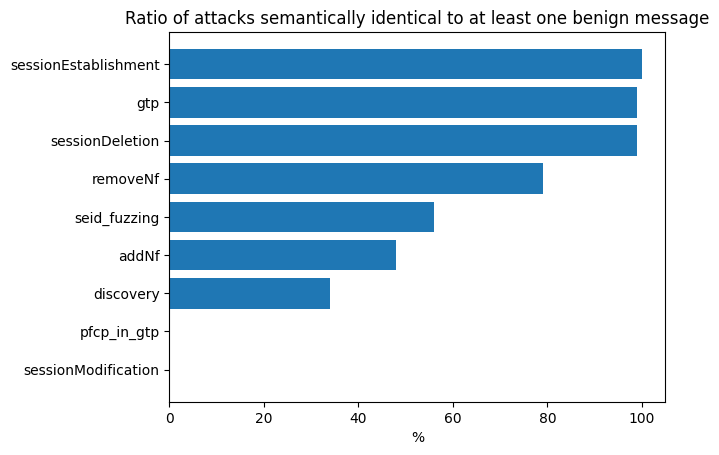

In [10]:
import matplotlib.pyplot as plt

sorted_items = sorted(percent_min_zero.items(), key=lambda x: x[1], reverse=False)
labels, values = zip(*sorted_items)

plt.barh(labels,values)
plt.title('Ratio of attacks semantically identical to at least one benign message')
plt.xlabel('%')
plt.show()

In [216]:
nb_no_zero = 0
nb_fuzz_func = 0

for nature,distances in result.items():
    if "/" in nature : 
        nb_fuzz_func += 1
        nb_zero = int(len(np.where(distances==0)[0]))
        if nb_zero > 0:
            nb_no_zero += 1

In [220]:
print(f"Percent of fuzzing requests never seen in normal {(1-nb_no_zero/nb_fuzz_func)*100}")


Percent of fuzzing requests never seen in normal 59.09090909090908


In [139]:
stats = {}

for nature, distances in result.items():
    
    stats[nature] = {
        "min": np.min(distances),
        "max": np.max(distances),
        "mean": np.mean(distances),
        "median": np.median(distances),
        "std": np.std(distances),
        "q1": np.percentile(distances, 25),
        "q3": np.percentile(distances, 75),
        "iqr": np.percentile(distances, 75) - np.percentile(distances, 25)
    }

In [140]:
# --- Conversion en DataFrame pour simplifier le plot ---
df = pd.DataFrame({k: pd.Series(v) for k, v in stats.items()})
df

,api_fuzzing,discovery,addNf,removeNf,sessionDeletion,sessionModification,sessionEstablishment,gtp,pfcp_in_gtp,seid_fuzzing
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.350877,0.0,0.000000,1.0,0.000000
max,1.000000,0.588235,0.500000,0.111111,0.939394,0.841463,0.0,0.955556,1.0,0.781818
mean,0.196036,0.164264,0.256410,0.023310,0.006180,0.635055,0.0,0.007837,1.0,0.253776
median,0.125000,0.090909,0.500000,0.000000,0.000000,0.628571,0.0,0.000000,1.0,0.000000
std,0.198463,0.162029,0.249918,0.045240,0.075944,0.120863,0.0,0.086184,0.0,0.312316
q1,0.125000,0.000000,0.000000,0.000000,0.000000,0.525641,0.0,0.000000,1.0,0.000000
q3,0.222222,0.300000,0.500000,0.000000,0.000000,0.705128,0.0,0.000000,1.0,0.477477
iqr,0.097222,0.300000,0.500000,0.000000,0.000000,0.179487,0.0,0.000000,0.0,0.477477


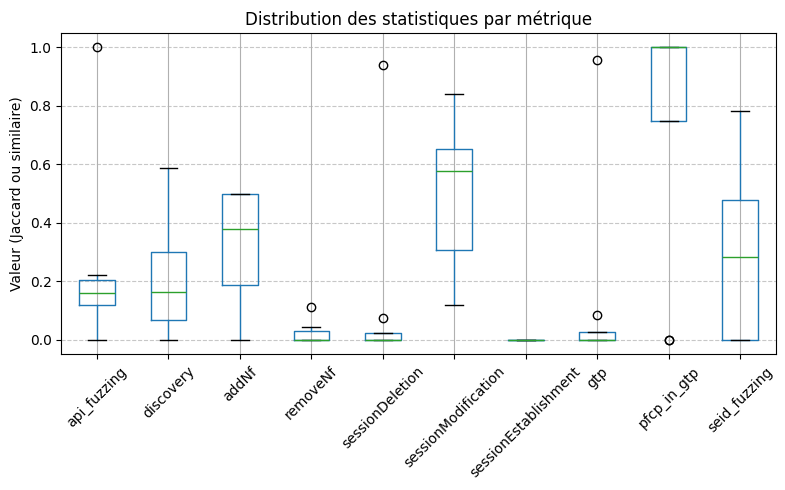

In [141]:
import matplotlib.pyplot as plt

plt.figure(figsize=(8, 5))
df.boxplot()
plt.title("Distribution des statistiques par métrique")
plt.ylabel("Valeur (Jaccard ou similaire)")
plt.xticks(rotation=45)
plt.grid(axis="y", linestyle="--", alpha=0.7)
plt.tight_layout()
plt.show()